<h1> Assignment 2 - Computer Vision (CSc8830) </h1>
<h3> Instructor: Dr. Ashwin Ashok - Spring 2024 </h3>
<h3> Student name: Reza Mansouri </h3>
<h4> Repository address: https://github.com/rezmansouri/CSC8830/tree/main/Assignment%202

<h4> Capture a 10 sec video footage using a camera of your choice. The footage should be taken with the camera in hand, and you need to pan the camera slightly from left-right or right-left during the 10 sec duration. For all the images, operate at grayscale unless otherwise specified. </h4>
<hr/>

## Question 1

<h4> Pick any image frame from the 10 sec video footage. Pick a region of interest in the image making sure there is an edge in that region. Pick a 5 x 5 image patch in that region that constitutes the edge. Perform the steps of Canny edge detection manually and note the pixels that correspond to the edge. Compare the outcome with MATLAB or OpenCV or DepthAI’s Canny edge detection function. </h4>
<hr/>

Frame 300 (second 10) of the captured video is first selected.

<img src="https://raw.githubusercontent.com/rezmansouri/CSC8830/main/Assignment%202/figures/1-1.png" alt="fig" width="700"/>

The selected 5 x 5 patch:

<img src="https://raw.githubusercontent.com/rezmansouri/CSC8830/main/Assignment%202/figures/1-2.png" alt="fig" width="200"/>

Resulting in the following image matrix ($I$):

$$
I = \begin{bmatrix}
    111 & 88 & 61 & 37 & 33 \\
    110 & 87 & 60 & 36 & 32 \\
    109 & 86 & 60 & 36 & 32 \\
    108 & 85 & 59 & 35 & 31 \\
    107 & 84 & 58 & 33 & 30 \\
\end{bmatrix}
$$

### Step 1: Gaussian smoothing

The first step is to perform Gaussian smoothing (blurring) to get rid of noisy pixels. It is done by convolving $I$ with a Gaussian kernel. As the image is 5 by 5, I choose a 3 by 3 kernel. The formula to obtain such Gaussian kernel, with $\mu = 0$ is:

$$
n_{\sigma}[i, j] = \frac{1}{2\pi\sigma^2} \exp \left( -\frac{1}{2} \left[ \frac{i^2 + j^2}{\sigma^2} \right] \right)
$$

With $\sigma = 1$ the kernel will approximately be:

$$
n_{\sigma} = \begin{bmatrix}
    0.06 & 0.12 & 0.06 \\
    0.12 & 0.25 & 0.12 \\
    0.06 & 0.12 & 0.06 \\
\end{bmatrix}
$$

In order to perform the convolution, $I$ should be padded to account for the peripheral pixel values. I choose to pad it with average pixel values, i.e., $64.32$, resulting in the following 7 by 7 matrix:

$$
I_{padded} = \begin{bmatrix}
    64.32 & 64.32 & 64.32 & 64.32 & 64.32 & 64.32 & 64.32 \\
    64.32 & 111 & 88 & 61 & 37 & 33 & 64.32 \\
    64.32 & 110 & 87 & 60 & 36 & 32 & 64.32 \\
    64.32 & 109 & 86 & 60 & 36 & 32 & 64.32 \\
    64.32 & 108 & 85 & 59 & 35 & 31 & 64.32 \\
    64.32 & 107 & 84 & 58 & 33 & 30 & 64.32 \\
    64.32 & 64.32 & 64.32 & 64.32 & 64.32 & 64.32 & 64.32
\end{bmatrix}
$$

Now we convolve $I_{padded}$ with $n_{\sigma}$. 
Doing it by hand will follow steps like this, multiplying the kernel with each window and summing up:

<img src="https://raw.githubusercontent.com/rezmansouri/CSC8830/main/Assignment%202/figures/1-3.png" alt="fig" width="500"/>

I used `opencv`'s `filter2D()` function for this computation, resulting in:

$$
I_{smoothed} = n_{\sigma} \ast I_{padded} = \begin{bmatrix}
86.08 & 81.08 & 62.14 & 47.33 & 47.27 \\
92.83 & 86.06 & 60.93 & 41.25 & 41.27 \\
92.08 & 85.18 & 60.31 & 40.75 & 40.89 \\
91.33 & 84.25 & 59.44 & 39.88 & 40.27 \\
84.20 & 78.77 & 60.08 & 45.33 & 45.83 \\
\end{bmatrix}
$$

### Step 2: Calculating gradients

The gradient of an image is calculated by convolving it with gradient kernel(s). I choose the sobel gradient kernel. The kernels for both directions are:

$$
\frac{\partial I}{\partial x} :
\begin{bmatrix}
    -1 & 0 & 1 \\
    -2 & 0 & 2 \\
    -1 & 0 & 1
\end{bmatrix}
$$

$$
\frac{\partial I}{\partial y} :
\begin{bmatrix}
    1 & 2 & 1 \\
    0 & 0 & 0 \\
    -1 & -2 & -1
\end{bmatrix}
$$

Once again, as we want to perform convolution, the smoothed image needs to be padded, and by my choice, with average values, i.e., $64.64$:
$$
I_{smoothed \ \& \ padded} = \begin{bmatrix}
64.64 & 64.64 & 64.64 & 64.64 & 64.64 & 64.64 & 64.64 \\
64.64 & 86.08 & 81.08 & 62.14 & 47.33 & 47.27 & 64.64 \\
64.64 & 92.83 & 86.06 & 60.93 & 41.25 & 41.27 & 64.64 \\
64.64 & 92.08 & 85.18 & 60.31 & 40.75 & 40.89 & 64.64 \\
64.64 & 91.33 & 84.25 & 59.43 & 39.88 & 40.27 & 64.64 \\
64.64 & 84.20 & 78.77 & 60.08 & 45.33 & 45.83 & 64.64 \\
64.64 & 64.64 & 64.64 & 64.64 & 64.64 & 64.64 & 64.64 \\
\end{bmatrix}
$$

The result of the convolutions, are gradients in both directions:

$$
I_{x} = \frac{\partial I_{smoothed \ \& \ padded}}{\partial x} = \begin{bmatrix}
54.30 & -79.76 & -112.31 & -49.43 & 58.01 \\
79.83 & -119.49 & -167.81 & -73.64 & 87.98 \\
82.13 & -127.32 & -178.06 & -77.68 & 95.94 \\
73.90 & -119.67 & -166.62 & -72.01 & 92.73 \\
47.86 & -80.14 & -111.25 & -47.67 & 63.38 \\
\end{bmatrix}
$$

$$
I_{y} = \frac{\partial I_{smoothed \ \& \ padded}}{\partial y} = \begin{bmatrix}
-77.80 & -67.33 & 9.37 & 73.85 & 70.13 \\
-16.11 & -12.39 & 6.13 & 21.36 & 19.32 \\
4.81 & 6.63 & 6.19 & 5.25 & 3.38 \\
22.17 & 20.95 & 2.31 & -13.86 & -14.45 \\
72.99 & 60.71 & -15.56 & -79.10 & -73.51 \\
\end{bmatrix}
$$

For edge detection, we need the gradient magnitude and orientation for each pixel. The following equations will do so:
$$
magnitude = S = \sqrt{I_{x}^2 + I_{y}^2}
$$

$$
orientation = \theta = \tan^{-1}\left(\frac{I_{y}}{I_{x}}\right)
$$

The results are:

$$
S=\begin{bmatrix}
94.88 & 104.38 & 112.70 & 88.87 & 91.01 \\
81.44 & 120.13 & 167.92 & 76.67 & 90.08 \\
82.27 & 127.49 & 178.17 & 77.86 & 95.99 \\
77.15 & 121.49 & 166.64 & 73.33 & 93.85 \\
87.28 & 100.54 & 112.33 & 92.36 & 97.06 \\
\end{bmatrix}
$$

$$
\theta=\left[\begin{matrix}
-0.30&0.23&-0.02&-0.30&0.28\\
-0.06&0.04&-0.01&-0.08&0.06\\
0.02&-0.02&-0.01&-0.02&0.01\\
0.09&-0.06&0&0.06&-0.05\\
0.31&-0.21&0.04&0.32&-0.27\\
\end{matrix}\right] \times \pi \approx \left [\begin{matrix}55°&42°&-3°&-55°&50°\\
-12°&7°&-2°&-15°&12°\\
4°&-4°&-2°&-4°&2°\\
18°&-11°&-1°&11°&-9°\\
56°&-38°&8°&59°&-49°
\end{matrix}\right]
$$

With the following reference trigonometric circle,

<img src="https://raw.githubusercontent.com/rezmansouri/CSC8830/main/Assignment%202/figures/1-4.png" alt="fig" width="250"/>

The direction of the gradients are visualized as:

<img src="https://raw.githubusercontent.com/rezmansouri/CSC8830/main/Assignment%202/figures/1-5.png" alt="fig" width="250"/>

Note that the orientations are calculated with `numpy.arctan()` such that they fall in between $[\frac{-\pi}{2}, \frac{\pi}{2}]$. Like so, a pixel might have $\theta = 225°$, but is calculated as $45°$, because they both have equal tangents. We are worried about orientation in edge detection, not direction.

### Step 3: Non-max suppression

$\theta$ for each pixel points to two neighboring pixels. In this step, non-max suppression is performed, such that between these three values, (1. the pixel pointed at by the arrow, 2. the pixel itself, and 3. the pixel at the end of the arrow), the maximum will be retained and the rest will be suppressed, i.e., set to $0$.

According to $\theta$ here are the coordinates neighbors for each pixel to be compared against (Invalid coordinates are shaded with gray):

<img src="https://raw.githubusercontent.com/rezmansouri/CSC8830/main/Assignment%202/figures/1-6.jpg" alt="fig" width="400"/>

The result is:
$$
S_{suppressed}=\left[\begin{matrix}
94.87&0&112.70&0&91.01\\
0&0&167.92&0&0\\
0&0&178.16&0&0\\
0&0&166.64&0&0\\
87.28&0&112.33&0&97.06\\
\end{matrix}\right]
$$


### Step 4: Double-thresholding

I declare the lower threshold as $0.3 \times max(S_{suppressed})$ and the higher as $0.7 \times max(S_{suppressed})$. Any value lower than the lower threshold, will be considered as non-edge, i.e., set to zero, and any value above the higher threshold will be considered as strong edge. The values in between are considered as weak edge, further to be processed in hysteresis analysis.

$$
thresh_{low} = 0.3 \times max(S_{suppressed}) = 0.3 \times 169 = 50.7
$$

$$
thresh_{high} = 0.7 \times max(S_{suppressed}) = 0.7 \times 169 = 118.3
$$

The result of the thresholding is (strong edges are italicized, no non-edge was thresholded):

$$
S_{suppressed\ \& \ thresholded}=\left[\begin{matrix}94.87&0&112.70&0&91.01\\0&0&\mathit{167.92}&0&0\\0&0&\mathit{178.16}&0&0\\0&0&\mathit{166.64}&0&0\\87.28&0&112.33&0&97.06\\\end{matrix}\right]
$$

### Step 5: Hysteresis analysis

Weak edge pixels in the neighborhood of strong edge pixels are considered as edge, and any other value is considered as non-edge. Resulting in:
$$
edges=\left[\begin{matrix}0&0&1&0&0\\0&0&\mathbf{1}&0&0\\0&0&\mathbf{1}&0&0\\0&0&\mathbf{1}&0&0\\0&0&1&0&0\\\end{matrix}\right]
$$

### Comparing with MATLAB's output

Script:

```matlab
img = imread('./patch.png');
edges = edge(img, 'Canny');
disp(edges);
imshow(edges,'InitialMagnification','fit');
```
Output:
```matlab
   0   0   0   0   0
   0   0   1   0   0
   0   0   1   0   0
   0   0   1   0   0
   0   0   0   0   0
```
<img src="https://raw.githubusercontent.com/rezmansouri/CSC8830/main/Assignment%202/figures/1-7.png" alt="fig" width="400"/>

<hr/>


## Question 2

<h4> 2. Pick any image frame from the 10 sec video footage. Pick a region of interest in the image making sure there is a CORNER in that region. Pick a 5 x 5 image patch in that region that constitutes the edge. Perform the steps of HARRIS CORNER DETECTION manually and note the pixels that correspond to the CORNER. Compare the outcome with MATLAB or OpenCV or DepthAI’s Harris corner detection function. </h4>
<hr/>

Frame 60 (second 2) of the captured video is first selected.

<img src="https://raw.githubusercontent.com/rezmansouri/CSC8830/main/Assignment%202/figures/2-1.png" alt="fig" width="700"/>

The selected 5 x 5 patch:

<img src="https://raw.githubusercontent.com/rezmansouri/CSC8830/main/Assignment%202/figures/2-2.png" alt="fig" width="200"/>

Resulting in the following image matrix ($I$):

$$
I = \begin{bmatrix}
    136 & 133 & 133 & 135 & 138 \\
    135 & 131 & 131 & 133 & 137 \\
    133 & 125 & 109 & 99 & 110 \\
    132 & 123 & 106 & 93 & 98 \\
    132 & 119 & 101 & 88 & 79 \\
\end{bmatrix}
$$

### Step 1: Gaussian smoothing

Same as question 1, first $I$ is padded with its average value, i.e., $119.56$:

$$
I_{padded} \left[\begin{matrix}119.56&119.56&119.56&119.56&119.56&119.56&119.56\\119.56&136&133&133&135&138&119.56\\119.56&135&131&131&133&137&119.56\\119.56&133&125&109&99&110&119.56\\119.56&132&123&106&93&98&119.56\\119.56&132&119&101&88&79&119.56\\119.56&119.56&119.56&119.56&119.56&119.56&119.56\\\end{matrix}\right]
$$

Convolving it with 3 by 3 Gaussian kernel with $\mu=0$ and $\sigma=1$,

$$
n_{\sigma} = \begin{bmatrix}
    0.06 & 0.12 & 0.06 \\
    0.12 & 0.25 & 0.12 \\
    0.06 & 0.12 & 0.06 \\
\end{bmatrix}
$$

leading to $I_{smoothed}$:
$$
I_{smoothed} = n_\sigma\ast\ I_{padded}=\left[\begin{matrix}86.07&81.08&62.14&47.23&47.26\\92.82&86.06&60.93&41.25&41.26\\92.07&85.18&60.31&40.75&40.89\\91.32&84.25&59.43&39.87&40.26\\84.20&78.76&60.08&45.33&45.82\\\end{matrix}\right]
$$

### Step 2: Calculating gradients

Padding $I_{smoothed}$ with its average, i.e., $119.24$:
$$
I_{smoothed\ \&\  padded} = \left[\begin{matrix}119.24&119.24&119.24&119.24&119.24&119.24&119.24\\119.24&86.07&81.08&62.14&47.23&47.26&119.24\\119.24&92.82&86.06&60.93&41.25&41.26&119.24\\119.24&92.07&85.18&60.31&40.75&40.89&119.24\\119.24&91.32&84.25&59.43&39.87&40.26&119.24\\119.24&84.20&78.76&60.08&45.33&45.82&119.24\\119.24&119.24&119.24&119.24&119.24&119.24&119.24\\\end{matrix}\right]
$$

Gradients in both directions via convolving $I_{smoothed\ \&\  padded}$ with sobel kernels, as defined in question 1 answer:

$$
I_{x} = \frac{\partial I_{smoothed \ \& \ padded}}{\partial x} = \left[\begin{matrix}31.99&0.02&-1.31&-1.15&-30.68\\37.93&-17.65&-20.87&-2.72&-17.05\\23.41&-49.24&-56.93&-8.94&33.52\\8.18&-69.64&-82.37&-18.97&74.19\\0.99&-53.16&-64.12&-18.65&63.12\\\end{matrix}\right]
$$

$$
I_{y} = \frac{\partial I_{smoothed \ \& \ padded}}{\partial y} = \left[\begin{matrix}-31.99&-39.92&-33.35&-29.43&-21.68\\4.97&24.64&55.30&72.52&52.72\\15.75&42.18&79.18&104.25&79.68\\13.02&22.22&31.06&41.47&35.40\\16.24&-2.25&-45.83&-74.81&-58.00\\\end{matrix}\right]
$$

### Step 3: Second moment matrices

For each pixel we'll define a second moment matrix $M$:

$$
M = \sum_{(x, y) \in w} w(x, y)\begin{bmatrix} I_{x}^2 & I_{xy}\\I_{xy} & I_{y}^2\end{bmatrix}
$$
where $w$ is a window function functioning as weights, explained later.

Thus, first we'll obtain $I_{x}^2$, ${I_{xy}}$, and $I_{y}^2$, via element-wise multiplication:

$$
{I_x}^2=\left[\begin{matrix}1023.84&0.00&1.72&1.32&941.56\\1438.68&311.52&435.76&7.42&290.87\\548.26&2425.31&3241.87&79.92&1123.75\\66.91&4851.11&6785.56&360.05&5504.89\\0.99&2826.25&4112.01&347.82&3985.07\\\end{matrix}\right]
$$

$$
I_{xy}=\left[\begin{matrix}-1023.84&-0.99&43.77&33.84&665.40\\188.70&-435.07&-1154.59&-197.63&-899.22\\368.78&-2077.62&-4508.73&-931.99&2671.32\\106.54&-1547.97&-2588.97&-786.98&2626.50\\16.20&120.01&2939.16&1395.39&-3661.55\\\end{matrix}\right]
$$

$$
{I_y}^2=\left[\begin{matrix}1023.83&1594.40&1112.38&866.12&470.23\\24.75&607.62&3059.19&5259.87&2779.92\\248.06&1779.78&6270.66&10868.06&6350.09\\169.65&493.95&965.03&1720.01&1253.16\\263.98&5.09&2100.84&5598.02&3364.28\\\end{matrix}\right]
$$

For the summation in $M$, we'll define the window function as a Gaussian kernel, weighting the underlying pixels in a normalized fashion, giving less weights to peripheral pixel values. Hence, the summation is a convolution with the our Gaussian kernel. Same 3 by 3 Gaussian kernel used for smoothing with $\mu=0$ and $\sigma=1$ is utilized.

Prior to the convolutions $I_{x}^2$, ${I_{xy}}$, and $I_{y}^2$ are padded with their averages:

$$
I^2_{x\ padded}=\left[\begin{matrix}1628.50&1628.50&1628.50&1628.50&1628.50&1628.50&1628.50\\1628.50&1023.84&0.00&1.72&1.32&941.56&1628.50\\1628.50&1438.68&311.52&435.76&7.42&290.87&1628.50\\1628.50&548.26&2425.31&3241.87&79.92&1123.75&1628.50\\1628.50&66.91&4851.11&6785.56&360.05&5504.89&1628.50\\1628.50&0.99&2826.25&4112.01&347.82&3985.07&1628.50\\1628.50&1628.50&1628.50&1628.50&1628.50&1628.50&1628.50\\\end{matrix}\right]
$$

$$
I_{xy \ padded}=\left[\begin{matrix}-344.38&-344.38&-344.38&-344.38&-344.38&-344.38&-344.38\\-344.38&-1023.84&-0.99&43.77&33.84&665.40&-344.38\\-344.38&188.70&-435.07&-1154.59&-197.63&-899.22&-344.38\\-344.38&368.78&-2077.62&-4508.73&-931.99&2671.32&-344.38\\-344.38&106.54&-1547.97&-2588.97&-786.98&2626.50&-344.38\\-344.38&16.20&120.01&2939.16&1395.39&-3661.55&-344.38\\-344.38&-344.38&-344.38&-344.38&-344.38&-344.38&-344.38\\\end{matrix}\right]
$$

$$
I^2_{y\ padded}=\left[\begin{matrix}2329.96&2329.96&2329.96&2329.96&2329.96&2329.96&2329.96\\2329.96&1023.83&1594.40&1112.38&866.12&470.23&2329.96\\2329.96&24.75&607.62&3059.19&5259.87&2779.92&2329.96\\2329.96&248.06&1779.78&6270.66&10868.06&6350.09&2329.96\\2329.96&169.65&493.95&965.03&1720.01&1253.16&2329.96\\2329.96&263.98&5.09&2100.84&5598.02&3364.28&2329.96\\2329.96&2329.96&2329.96&2329.96&2329.96&2329.96&2329.96\\\end{matrix}\right]
$$

Now, performing the convolutions, i.e., the summations over a Gaussian window:

$$
{S_x}^2 = n_\sigma \ast I^2_{x\ padded} =\left[\begin{matrix}1167.73&691.41&482.12&571.71&984.85\\1153.83&916.33&710.92&434.65&744.01\\1358.22&2270.86&2371.93&1425.19&1445.49\\1427.12&3219.74&3622.00&2458.71&2493.69\\1377.56&2662.49&3005.79&2319.38&2462.83\\\end{matrix}\right]
$$

$$
S_{xy} = n_\sigma \ast I_{xy \ padded} =\left[\begin{matrix}-410.35&-323.60&-254.91&-142.05&-104.84\\-305.09&-809.33&-1111.906&-488.91&25.35\\-340.63&-1498.42&-2153.06&-709.89&619.60\\-327.18&-1012.28&-1221.19&-290.36&377.34\\-215.04&-33.44&372.31&78.30&-612.50\\\end{matrix}\right]
$$

$$
{S_y}^2 = n_\sigma \ast I^2_{y\ padded} =\left[\begin{matrix}1515.69&1516.82&1917.27&2019.28&1921.42\\1034.50&1500.10&3365.39&4399.34&3520.88\\960.12&1661.14&4156.77&5670.69&4468.91\\862.20&1043.65&2705.14&3895.94&3354.23\\1138.07&1012.03&2067.10&3018.80&2824.34\\\end{matrix}\right]
$$

Now for pixel $(x, y)$, M is $\begin{bmatrix}{S_x}^2&S_{xy}\\ S_{xy}&{S_y}^2\end{bmatrix}$

### Step 4: Corner response function

The corner response function $R$ for each pixel is calculated via its $M$. It is:

$$
R = \lambda_{1}\lambda_{2} - \alpha (\lambda_{1}+\lambda_{2})^2
$$

Where $\lambda_{1}$ and $\lambda_{2}$ are eigenvalues of $M$ and $\alpha$ is a small constant such as $0.05$.

First, let's find $\lambda_{1}$ and $\lambda_{2}$ for all pixel values:

$$
\lambda_{1, 2} = 
\begin{bmatrix}
(896.0017, 1787.4283) & (579.67194, 1628.5652) & (438.19394, 1961.2074) & (557.90326, 2033.0901) & (973.2598, 1933.0127) \\
(1405.0492, 783.29156) & (347.85956, 2068.58) & (306.71432, 3769.5964) & (375.2474, 4458.746) & (743.7852, 3521.1182) \\
(1553.704, 764.647) & (3495.1306, 436.8811) & (933.66846, 5595.0405) & (1309.636, 5786.2573) & (1323.442, 4590.9663) \\
(1576.9064, 712.4279) & (3617.821, 645.5764) & (4467.983, 1859.1656) & (2402.271, 3952.3953) & (2351.673, 3496.256) \\
(1503.9518, 1011.6813) & (2663.168, 1011.3541) & (3135.5334, 1937.3657) & (2310.7253, 3027.4592) & (2004.9701, 3282.2078) \\
\end{bmatrix}
$$

Resulting in response values:

$$
R=\left[\begin{matrix}1961578.8&1187849.1&1147245.5&1469930.00&2303644.5\\1340004.9&1011543.44&1987004.8&2841507.5&3528425.8\\1456772.6&2299992.2&7355115.00&10095476.00&7824888.5\\1385484.6&3244408.00&10308361.00&11513814.00&9931965.00\\1837940.4&3368511.5&7361390.5&8420438.00&7978441.00\\\end{matrix}\right]
$$

### Step 5: Thresholding and Non-max suppression

We'll threshold R with its average value, i.e., $4526469.00$. Any pixel with lower values than the threshold will be eliminated as a corner candidate:

$$
R_{thresholded} = \left[\begin{matrix}0&0&0&0&0\\0&0&0&0&0\\0&0&7355115.00&10095476.00&7824888.5\\0&0&10308361.00&11513814.00&9931965.00\\0&0&7361390.5&8420438.00&7978441.00\\\end{matrix}\right]
$$

Now performing non-max suppression, for each pixel, its R value is compared against all of its 8 neigbors, maximum is retained, rest is suppressed, i.e., set to $0$:

$$
R_{thresholded \ \& \ suppressed}=\left[\begin{matrix}0&0&0&0&0\\0&0&0&0&0\\0&0&0&0&0\\0&0&0&11513814.00&0\\0&0&0&0&0\\\end{matrix}\right]
$$

The final corners detected are: 

$$
corners=\left[\begin{matrix}0&0&0&0&0\\0&0&0&0&0\\0&0&0&0&0\\0&0&0&1&0\\0&0&0&0&0\\\end{matrix}\right]
$$


### Comparing with MATLAB's output

Script:

```matlab
img = imread('patch.png');
corners = detectHarrisFeatures(img, 'FilterSize', 3);
disp(corners);
imshow(img); hold on;
plot(corners);
```
Output:

<img src="https://raw.githubusercontent.com/rezmansouri/CSC8830/main/Assignment%202/figures/2-3.png" alt="fig" width="400"/>

<hr/>

## Question 3

<h4> Consider an image pair from your footage where the images are separated by at least 2 seconds. Also ensure there is at least some overlap of scenes in the two images.</h4>


## 3.a
<h4>
 Pick a pixel (super-pixel patch as discussed in class) on image 1 and a corresponding pixel (super-pixel patch as discussed in class) on image 2 (the pixel on image 2 that corresponds to the same object area on image 1). Compute the SIFT feature for each of these 2 patches. Compute the sum of squared difference (SSD) value between the SIFT vector for these two pixels. Use MATLAB or Python or C++ implementation. </h4>
<hr/>

### Step 1: Packages and helper functions

In [1]:
import cv2 as cv
import numpy as np
import matplotlib.pyplot as plt

In [2]:
# helper function for reading images in grayscale
def read_grayscale_image(path):
    return cv.imread(path, cv.IMREAD_GRAYSCALE)

# helper function for plotting two images
def biplot_grayscale(img1, img2, title1, title2, figsize=None):
    plt.figure(figsize=figsize)
    plt.subplot(1, 2, 1)
    plt.axis('off')
    plt.title(title2)
    plt.imshow(img2, cmap='gray')
    plt.subplot(1, 2, 2)
    plt.axis('off')
    plt.title(title1)
    plt.imshow(img1, cmap='gray')
    plt.show()

# helper function for padding grayscale images with their average value
def avg_pad(img):
    n_rows, n_cols = img.shape
    img_padded = np.full((n_rows + 2, n_cols + 2), np.average(img), dtype=np.float32)
    img_padded[1:n_rows+1, 1:n_rows+1] = img
    return img_padded

# helper function for cropping out first and last pixel values in grayscale images
# opencv's filter2D output returns arbitrary values in those pixels, not of our interest
def crop(img):
    n_rows, n_cols = img.shape
    return img[1:n_rows-1, 1:n_cols-1]

### Step 2: Reading the images
Frame 150 (second 5) named source, and 210 (second 7) named destination are selected.

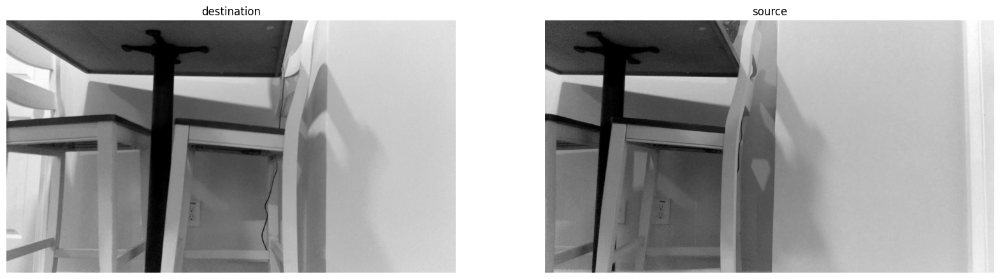

In [3]:
src_img = read_grayscale_image('input/frame_150.png')
des_img = read_grayscale_image('input/frame_210.png')
biplot_grayscale(src_img, des_img, 'source', 'destination', figsize=(20, 10))

### Step 3: Patch (superpixel) selection

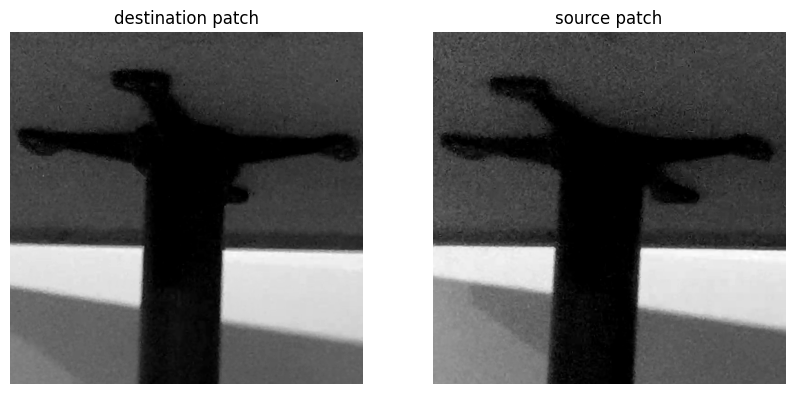

In [4]:
src_patch = src_img[:776,230:1006]
des_patch = des_img[:776,965:1741]
biplot_grayscale(src_patch, des_patch, 'source patch', 'destination patch', figsize=(10, 5))

### Step 4: Smoothing the patches

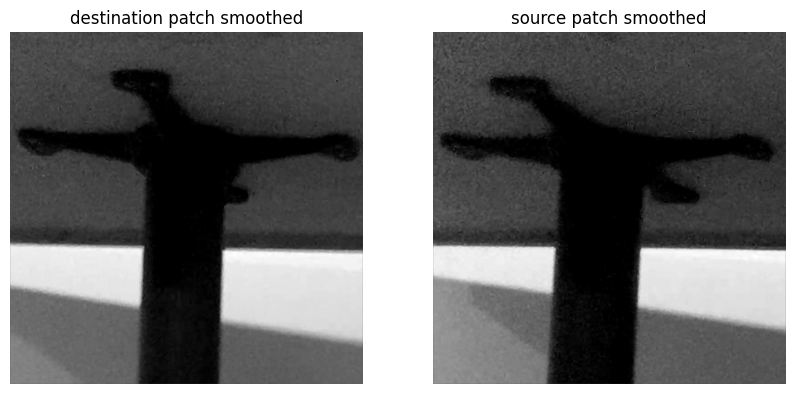

In [5]:
gaussian = np.array([[1, 2, 1], 
                     [2, 4, 2], 
                     [1, 2, 1]]) / 16
src_patch_smooth = crop(cv.filter2D(avg_pad(src_patch), -1, gaussian))
des_patch_smooth = crop(cv.filter2D(avg_pad(des_patch), -1, gaussian))
biplot_grayscale(src_patch_smooth, des_patch_smooth, 'source patch smoothed', 'destination patch smoothed', figsize=(10, 5))

### Step 5 & 6: Gradient calculation & histogramming gradient orientations

In [6]:
sobel_x = np.array([[-1, 0, 1], 
                    [-2, 0, 2], 
                    [-1, 0, 1]], np.float32)
sobel_y = np.array([[1, 2, 1], 
                    [0, 0, 0], 
                    [-1, -2, -1]], np.float32)

In [7]:
print('src shape:', src_patch_smooth.shape)
print('des shape:', des_patch_smooth.shape)

src shape: (776, 776)
des shape: (776, 776)


The following function will discretize gradient orientations into 8 bins, based on this circle:

<img src="https://raw.githubusercontent.com/rezmansouri/CSC8830/main/Assignment%202/figures/3-1.png" alt="fig" width="400"/>

In [8]:
def discretize(orientation):
    orientation_indices = np.zeros(orientation.shape, dtype=np.uint8)
    # 8 bins, each one equivalent to pi / 4, i.e., 45 degrees
    orientation_indices[np.logical_and(orientation > -1/8, orientation <= 1/8)] = 0
    orientation_indices[np.logical_and(orientation > 1/8, orientation <= 3/8)] = 1
    orientation_indices[np.logical_and(orientation > 3/8, orientation <= 5/8)] = 2
    orientation_indices[np.logical_and(orientation > 5/8, orientation <= 7/8)] = 3
    orientation_indices[np.logical_or(np.logical_and(orientation > 7/8, orientation <= 1), 
                                      np.logical_and(orientation > -1, orientation <= -7/8))] = 4
    orientation_indices[np.logical_and(orientation > -7/8, orientation <= -5/8)] = 5
    orientation_indices[np.logical_and(orientation > -5/8, orientation <= -3/8)] = 6
    orientation_indices[np.logical_and(orientation > -3/8, orientation <= -1/8)] = 7
    return orientation_indices

Patches are $776 \times 776$. We are going to devide them into $194 \times 194$, ($776 \div 4 = 194$) super-pixels and do gradient histogramming on them. We'll have 16 subpatches.

In [9]:
def sift(img):
    subpatch_dim = img.shape[0] // 4
    sift = []
    for i in range(0, img.shape[0], subpatch_dim):
        for j in range(0, img.shape[0], subpatch_dim):

            subpatch = np.array(img[i:i+subpatch_dim, j:j+subpatch_dim], dtype=np.float32)

            subpatch_x = crop(cv.filter2D(avg_pad(subpatch), -1, sobel_x))
            subpatch_y = crop(cv.filter2D(avg_pad(subpatch), -1, sobel_y))

            magnitude = np.array(np.sqrt(np.power(subpatch_x, 2) + np.power(subpatch_y, 2)), np.float32)
            # to avoid nan in orientation, it is replaced with arctan(patch_y)
            subpatch_x[subpatch_x == 0] = 1
            orientation = np.array(np.arctan2(subpatch_y, subpatch_x) / np.pi, np.float32)
            orientation_indices = discretize(orientation)
            # histogramming
            sums = np.zeros(8, dtype=np.float32)
            for i in range(8):
                sums[i] = np.sum(magnitude[orientation_indices == i])
            hist = sums / sums.max()
            sift.append(hist)
    return np.array(sift, dtype=np.float32).flatten()

In [10]:
src_patch_smooth_sift = sift(src_patch_smooth)
print('sift descriptor of src patch\nshape: ', src_patch_smooth_sift.shape, '\nvector: \n', src_patch_smooth_sift)

sift descriptor of src patch
shape:  (128,) 
vector: 
 [0.9075683  0.7495617  0.9319097  0.80269414 1.         0.7474684
 0.92048734 0.7426262  0.8339824  0.91083354 1.         0.71034944
 0.8866814  0.6530582  0.9802781  0.6064962  0.9532117  0.77028
 1.         0.77596456 0.9123123  0.6922752  0.96643853 0.6903995
 0.9705514  0.8673274  1.         0.85011697 0.96080625 0.75582236
 0.9834849  0.78547156 0.7419206  0.6002675  0.99767476 0.66976285
 0.734502   0.74942625 1.         0.61116225 0.8339824  0.91083354
 1.         0.71034944 0.8866814  0.6530582  0.9802781  0.6064962
 0.9532117  0.77028    1.         0.77596456 0.9123123  0.6922752
 0.96643853 0.6903995  0.9705514  0.8673274  1.         0.85011697
 0.96080625 0.75582236 0.9834849  0.78547156 0.3343172  0.20809262
 0.8484642  0.17076978 0.32793427 0.17092583 1.         0.16313998
 0.8339824  0.91083354 1.         0.71034944 0.8866814  0.6530582
 0.9802781  0.6064962  0.9532117  0.77028    1.         0.77596456
 0.9123123  0.6

In [11]:
des_patch_smooth_sift = sift(des_patch_smooth)
print('sift descriptor of src patch\nshape: ', des_patch_smooth_sift.shape, '\nvector: \n', des_patch_smooth_sift)

sift descriptor of src patch
shape:  (128,) 
vector: 
 [0.93315834 0.81193537 0.93743926 0.806979   1.         0.72335047
 0.94105285 0.7356568  0.74498224 0.67993045 1.         0.6479386
 0.72594917 0.6529146  0.90695167 0.43057463 0.9724066  0.87111026
 0.9530718  0.79045355 0.94080156 0.60311973 1.         0.6355254
 0.8892951  0.8862987  1.         0.7361516  0.89772755 0.71128386
 0.996698   0.66800433 0.6217153  0.45432177 1.         0.4923902
 0.6058223  0.6534194  0.95569843 0.45005694 0.74498224 0.67993045
 1.         0.6479386  0.72594917 0.6529146  0.90695167 0.43057463
 0.9724066  0.87111026 0.9530718  0.79045355 0.94080156 0.60311973
 1.         0.6355254  0.8892951  0.8862987  1.         0.7361516
 0.89772755 0.71128386 0.996698   0.66800433 0.29287592 0.16119416
 0.7228418  0.11335117 0.2655536  0.07691878 1.         0.07563148
 0.74498224 0.67993045 1.         0.6479386  0.72594917 0.6529146
 0.90695167 0.43057463 0.9724066  0.87111026 0.9530718  0.79045355
 0.94080156 

### Step 7: Sum of squared difference
$$
ssd = \sum_{i=0}^{n-1} (x_i - y_i)^2
$$

In [12]:
def ssd(vec1, vec2):
    return np.sum(np.power(vec1 - vec2, 2))

In [13]:
print('sum of squared difference for src patch and des patch:\n', ssd(src_patch_smooth_sift, des_patch_smooth_sift))

sum of squared difference for src patch and des patch:
 1.4491872


## 3.b
<h4>
Compute the Homography matrix between these two images using MATLAB or Python or C++ implementation. Compute its inverse.
</h4>
<hr/>

### Packages and helper functions:

In [1]:
import cv2 as cv
import numpy as np
import matplotlib.pyplot as plt

In [2]:
# helper function for reading images in grayscale
def read_grayscale_image(path):
    return cv.imread(path, cv.IMREAD_GRAYSCALE)

# helper function for plotting two images
def biplot_grayscale(img1, img2, title1, title2, figsize=None):
    plt.figure(figsize=figsize)
    plt.subplot(1, 2, 1)
    plt.axis('off')
    plt.title(title2)
    plt.imshow(img2, cmap='gray')
    plt.subplot(1, 2, 2)
    plt.axis('off')
    plt.title(title1)
    plt.imshow(img1, cmap='gray')
    plt.show()

# this function plots two images and lays the given keypoints on top of them in different colors
def plot_grayscale_with_keypoints(img1, img2, kp_1, kp_2, title1, title2, figsize=None):
    overlay_1 = np.zeros(img1.shape)
    overlay_2 = np.zeros(img2.shape)
    for i in range(kp_1.shape[0]):
        y, x = kp_1[i]
        overlay_1[y-25:y+25, x-25:x+25] = (i+2) * 50
        y, x = kp_2[i]
        overlay_2[y-25:y+25, x-25:x+25] = (i+2) * 50
    plt.figure(figsize=figsize)
    plt.subplot(1, 2, 1)
    plt.axis('off')
    plt.title(title2)
    plt.imshow(img2, cmap='gray')
    plt.imshow(overlay_2, cmap='magma', alpha=.4)
    plt.subplot(1, 2, 2)
    plt.axis('off')
    plt.title(title1)
    plt.imshow(img1, cmap='gray')
    plt.imshow(overlay_1, cmap='magma', alpha=.4)
    plt.show()

### Step one: Choosing keypoints
First, lets see the images and choose 4 corresponding keypoints in each.

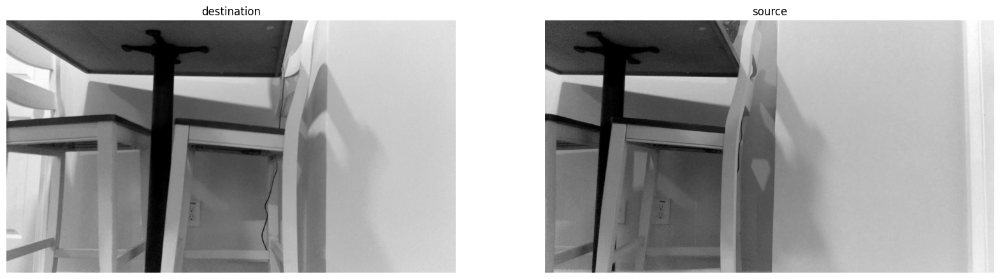

In [3]:
src_gray = read_grayscale_image('input/frame_150.png')
des_img = read_grayscale_image('input/frame_210.png')
biplot_grayscale(src_img, des_img, 'source', 'destination', figsize=(20, 10))

The chosen keypoints in each are (plotted in colored squares):

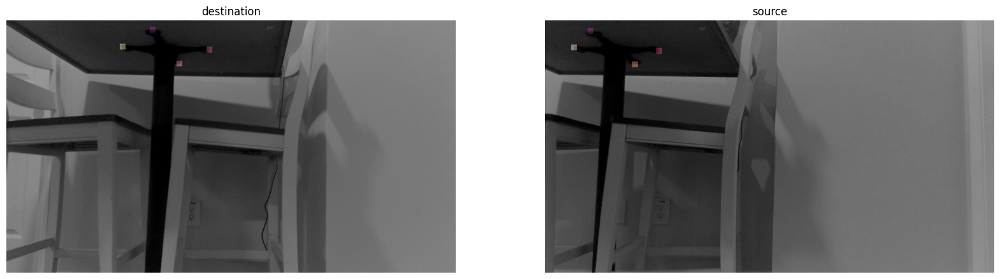

In [4]:
src_keypoints = np.array([[96, 389], [266, 976], [380, 770], [236, 248]], dtype='int')
des_keypoints = np.array([[86, 1250], [256, 1735], [374, 1478], [229, 994]], dtype='int')
plot_grayscale_with_keypoints(src_img, des_img, src_keypoints, des_keypoints, 'source', 'destination', (20, 10))

P.S.: the center of the colored squares are our keypoints.

The homography matrix can be obtained by 
1. Defining a matrix $A$ as:
$$
\mathbf{A} = \begin{bmatrix}
-x_1 & -y_1 & -1 & 0 & 0 & 0 & x_1'x_1 & x_1' y_1 & x_1' \\
0 & 0 & 0 & -x_1 & -y_1 & -1 & y_1'x_1 & y_1' y_1 & y_1 \\
-x_2 & -y_2 & -1 & 0 & 0 & 0 & x_2'x_2 & x_2' y_2 & x_2' \\
0 & 0 & 0 & -x_2 & -y_2 & -1 & y_2'x_2 & y_2' y_2 & y_2 \\
\vdots & \vdots & \vdots & \vdots & \vdots & \vdots & \vdots & \vdots & \vdots \\
-x_n & -y_n & -1 & 0 & 0 & 0 & x_n'x_n & x_n' y_n & x_n' \\
0 & 0 & 0 & -x_n & -y_n & -1 & y_n'x_n & y_n' y_n & y_n \\
0 & 0 & 0 & 0 & 0 & 0 & 0 & 0 & 1 \\
\end{bmatrix}
$$

2. Solving for $A \begin{bmatrix}h1\\\vdots\\h9\end{bmatrix} = \begin{bmatrix}0\\\vdots\\1\end{bmatrix} $ and reshaping $\begin{bmatrix}h1\\\vdots\\h9\end{bmatrix}$ to $\begin{bmatrix}h1 & h2 & h3\\h4 & h5 & h6\\h7 & h8 & h9\end{bmatrix}$.

### Step two: forming the $A$ matrix

In [5]:
A = np.zeros((src_keypoints.shape[0] * 2 + 1, 9), dtype=np.float32)
xs, ys, xd, yd = src_keypoints[:, 1], src_keypoints[:, 0], des_keypoints[:, 1], des_keypoints[:, 0]
j = 0
for i in range(src_keypoints.shape[0]):
    A[j] = [xs[i], ys[i], 1, 0, 0, 0, -xd[i] * xs[i], -xd[i] * ys[i], -xd[i]]
    A[j+1] = [0, 0, 0, xs[i], ys[i], 1, -yd[i] * xs[i], -yd[i] * ys[i], -yd[i]]
    j += 2
A[8, 8] = 1
print(A)

[[ 3.89000e+02  9.60000e+01  1.00000e+00  0.00000e+00  0.00000e+00
   0.00000e+00 -4.86250e+05 -1.20000e+05 -1.25000e+03]
 [ 0.00000e+00  0.00000e+00  0.00000e+00  3.89000e+02  9.60000e+01
   1.00000e+00 -3.34540e+04 -8.25600e+03 -8.60000e+01]
 [ 9.76000e+02  2.66000e+02  1.00000e+00  0.00000e+00  0.00000e+00
   0.00000e+00 -1.69336e+06 -4.61510e+05 -1.73500e+03]
 [ 0.00000e+00  0.00000e+00  0.00000e+00  9.76000e+02  2.66000e+02
   1.00000e+00 -2.49856e+05 -6.80960e+04 -2.56000e+02]
 [ 7.70000e+02  3.80000e+02  1.00000e+00  0.00000e+00  0.00000e+00
   0.00000e+00 -1.13806e+06 -5.61640e+05 -1.47800e+03]
 [ 0.00000e+00  0.00000e+00  0.00000e+00  7.70000e+02  3.80000e+02
   1.00000e+00 -2.87980e+05 -1.42120e+05 -3.74000e+02]
 [ 2.48000e+02  2.36000e+02  1.00000e+00  0.00000e+00  0.00000e+00
   0.00000e+00 -2.46512e+05 -2.34584e+05 -9.94000e+02]
 [ 0.00000e+00  0.00000e+00  0.00000e+00  2.48000e+02  2.36000e+02
   1.00000e+00 -5.67920e+04 -5.40440e+04 -2.29000e+02]
 [ 0.00000e+00  0.00000e

### Step three: Solving for $H$

In [18]:
b = [0] * 8 + [1]
H_flat = np.linalg.solve(A, b)
H = np.reshape(H_flat, (3,3))
print(H)

[[ 1.40253354e+00 -1.00652184e+00  8.73147829e+02]
 [ 4.70604789e-02  1.01600726e+00 -2.48822426e+01]
 [ 2.15218897e-04 -2.71190911e-04  1.00000000e+00]]


### Computing $H^{-1}$

In [19]:
H_inverse = np.linalg.inv(H)
print(H)

[[ 1.40253354e+00 -1.00652184e+00  8.73147829e+02]
 [ 4.70604789e-02  1.01600726e+00 -2.48822426e+01]
 [ 2.15218897e-04 -2.71190911e-04  1.00000000e+00]]


### Verifying $H$

In [20]:
ix = 0
src = np.array([src_keypoints[ix, 1], src_keypoints[ix, 0], 1])
des = np.array([des_keypoints[ix, 1], des_keypoints[ix, 0], 1])
print('src:', src)
print('des:', des)
calculated_des = H @ src
calculated_des = calculated_des / calculated_des[2]
print('des with H:', np.array(calculated_des, dtype='int'))

src: [389  96   1]
des: [1250   86    1]
des with H: [1249   86    1]


<hr/>

## Question 4

Implement an application that will compute and display the INTEGRAL image feed along with the RGB feed. You cannot use a built-in function such as “output = integral_image(input)”

<hr/>

### Helper functions & packages

In [1]:
import cv2 as cv
import numpy as np
import matplotlib.pyplot as plt

In [2]:
# normalize an array to have values in [0, 255]
def normalize(arr):
    min = np.min(arr)
    max = np.max(arr)
    _range = max - min
    scaled_image = ((arr - min) / _range) * 255
    return np.array(scaled_image, dtype=np.uint8)

# read rgb image
def read_rgb_image(path):
    return plt.imread(path)

# plot rgb and grayscale
def plot_rgb_grayscale(rgb, grayscale, title1, title2, figsize=None):
    plt.figure(figsize=figsize)
    plt.subplot(1, 2, 1)
    plt.axis('off')
    plt.title(title2)
    plt.imshow(grayscale, cmap='gray')
    plt.subplot(1, 2, 2)
    plt.axis('off')
    plt.title(title1)
    plt.imshow(rgb)
    plt.show()

### Calculating integral image
If we iterate over pixels according to the following figure, integral value for each pixel will be:

<img src="https://raw.githubusercontent.com/rezmansouri/CSC8830/main/Assignment%202/figures/4-1.png" alt="fig" width="400"/>

$A + B + C - D$



In [23]:
def compute_integral(rgb):
    integral = cv.cvtColor(rgb, cv.COLOR_BGR2GRAY)
    n_rows, n_cols = integral.shape
    for i in range(n_rows):
        for j in range(n_cols):
            a = integral[i, j]
            b = integral[i-1, j] if i > 0 else 0
            c = integral[i, j-1] if j > 0 else 0
            d = integral[i-1, j-1] if i > 0 and j > 0 else 0
            integral[i, j] = a + b + c - d
    return integral

### Verifying

In [24]:
rgb = read_rgb_image('input/frame_300.png')
integral = compute_integral(rgb)
print('integral bottom right 5 x 5 patch:\n', integral[-5:, -5:])

integral bottom right 5 x 5 patch:
 [[4723157.  4724953.  4726760.  4728560.5 4730368. ]
 [4725786.  4727583.  4729391.  4731192.  4733000.5]
 [4728421.5 4730220.  4732029.  4733831.  4735640. ]
 [4731029.  4732828.5 4734638.  4736441.  4738251. ]
 [4733649.  4735449.  4737259.5 4739064.  4740875. ]]


As can be seen, the values in the integral tend to become more and more as the computation progresses, i.e., for latter pixels. Thus, for visualization, we'll normalize it to have values between 0 and 255.

normalized bottom right 5 x 5 patch:
 [[254 254 254 254 254]
 [254 254 254 254 254]
 [254 254 254 254 254]
 [254 254 254 254 254]
 [254 254 254 254 255]]


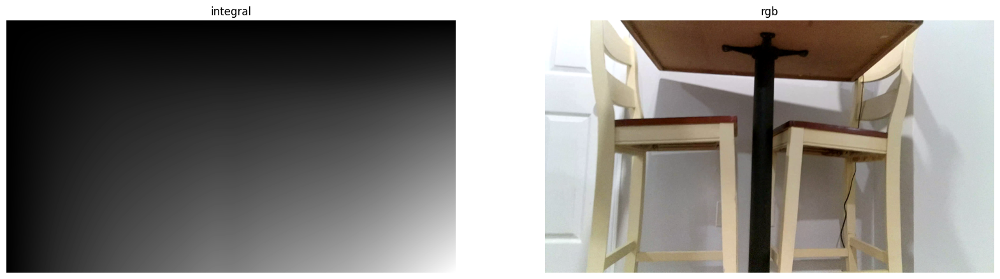

In [25]:
integral_normalized = normalize(integral)
print('normalized bottom right 5 x 5 patch:\n', integral_normalized[-5:, -5:])
plot_rgb_grayscale(rgb, integral, 'rgb', 'integral', (20, 10))

<hr/>

## Question 5

<h4>
Implement the image stitching for a 360 degree panoramic output. This should function in real-time. You can use any type of features. You can use built-in libraries/tools provided by OpenCV or DepthAI API. You cannot use any built-in function that does output = image_stitch(image1, image2). You are supposed to implement the image_stitch() function.

</h4>

<hr/>

### Packages and helper functions

In [1]:
import os
import cv2 as cv
import numpy as np
import matplotlib.pyplot as plt

In [2]:
# helper function for reading images in rgb
def read_rgb_image(path):
    return plt.imread(path)

# helper function for reading multiple images in rgb
def read_rgb_images(path):
    paths = sorted(os.listdir(path))
    rgbs = []
    for i in range(len(paths)):
        rgbs.append(plt.imread(f'{path}/{paths[i]}'))
    return rgbs

# helper function for converting images to grayscale
def convert_to_grayscale(img):
    return cv.cvtColor(img, cv.COLOR_BGR2GRAY)

def plot(img, title='', figsize=None, cmap=None):
    plt.figure(figsize=figsize)
    plt.axis('off')
    plt.title(title)
    plt.imshow(img, cmap=cmap)
    plt.show()
    

# helper function for plotting two images
def biplot(img1, img2, title1='', title2='', figsize=None, cmap=None):
    plt.figure(figsize=figsize)
    plt.subplot(1, 2, 1)
    plt.axis('off')
    plt.title(title1)
    plt.imshow(img1, cmap=cmap)
    plt.subplot(1, 2, 2)
    plt.axis('off')
    plt.title(title2)
    plt.imshow(img2, cmap=cmap)
    plt.show()

# helper function for plotting three images
def triplot(img1, img2, img3, title1='', title2='', title3='', figsize=None, cmap=None):
    plt.figure(figsize=figsize)
    plt.subplot(1, 3, 1)
    plt.axis('off')
    plt.title(title1)
    plt.imshow(img1, cmap=cmap)
    plt.subplot(1, 3, 2)
    plt.axis('off')
    plt.title(title2)
    plt.imshow(img2, cmap=cmap)
    plt.subplot(1, 3, 3)
    plt.axis('off')
    plt.title(title3)
    plt.imshow(img3, cmap=cmap)
    plt.show()
    
# helper function to plot many images
def plot_multiple(imgs, figsize=None):
    plt.figure(figsize=figsize)
    n = len(imgs)
    for i in range(n):
        plt.subplot(1, n, i+1)
        plt.axis('off')
        plt.imshow(imgs[i])
    plt.show()
    
# helper function to crop out empty (black) areas in the image    
def remove_empty_space(img):
    start_col = 0
    for i in range(img.shape[1]):
        if np.all(img[:, i] == 0):
            start_col += 1
        else:
            break
    end_col = img.shape[1] + 1
    for i in range(1, img.shape[1]):
        if np.all(img[:, -i] == 0):
            end_col -= 1
    start_row = 0
    for i in range(img.shape[0]):
        if np.all(img[i, :] == 0):
            start_row += 1
        else:
            break
    end_row = img.shape[0] + 1
    for i in range(1, img.shape[0]):
        if np.all(img[-i, :] == 0):
            end_row -= 1
    return img[start_row:end_row, start_col:end_col]


### Stitching only two

First lets do stiching for two images. Images are from the APAP dataset (Zaragoza et. al "As-Projective-As-Possible Image Stitching with Moving DLT," 2013).

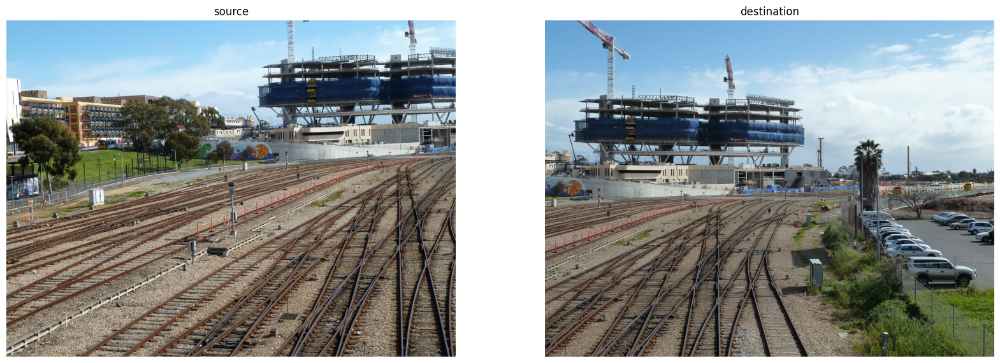

In [15]:
src_rgb = read_rgb_image('input/pano/dataset_1/1.JPG')
des_rgb = read_rgb_image('input/pano/dataset_1/2.JPG')
biplot(src_rgb, des_rgb, 'source', 'destination', figsize=(20, 10))

Converting them to grayscale for keypoint & sift calculation:

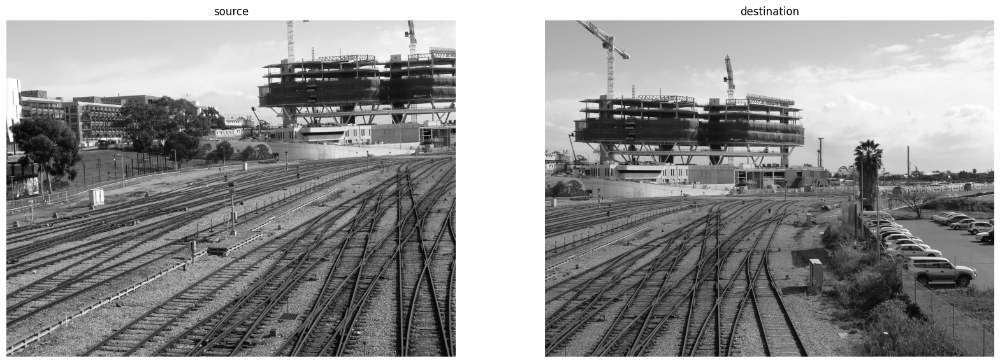

In [16]:
src_gray = convert_to_grayscale(src_rgb)
des_gray = convert_to_grayscale(des_rgb)
biplot(src_gray, des_gray, 'source', 'destination', figsize=(20, 10), cmap='gray')

### Step one: calculating SIFT features and finding keypoints

In [17]:
sift = cv.SIFT_create()
src_keypoints, src_sift = sift.detectAndCompute(src_gray, None)
des_keypoints, des_sift = sift.detectAndCompute(des_gray, None)

### Step two: finding matches

In [18]:
bf = cv.BFMatcher()
matches = bf.knnMatch(src_sift, des_sift, k=2)

Filtering good matches based on $k$-nearest neighbor distance:

In [19]:
good = []
for m in matches:
    if m[0].distance < 0.5 * m[1].distance:
        good.append(m)
if len(good) < 4:
    raise AssertionError('not enough matching keypoints found')
matches = np.asarray(good)

### Step three: finding homography matrix

In [20]:
src = np.float32(
    [src_keypoints[m.queryIdx].pt for m in matches[:, 0]]).reshape(-1, 1, 2)
des = np.float32(
    [des_keypoints[m.trainIdx].pt for m in matches[:, 0]]).reshape(-1, 1, 2)
H, _ = cv.findHomography(des, src, cv.RANSAC, 5.0)

### Step four: warping the destination image and stitching the source image

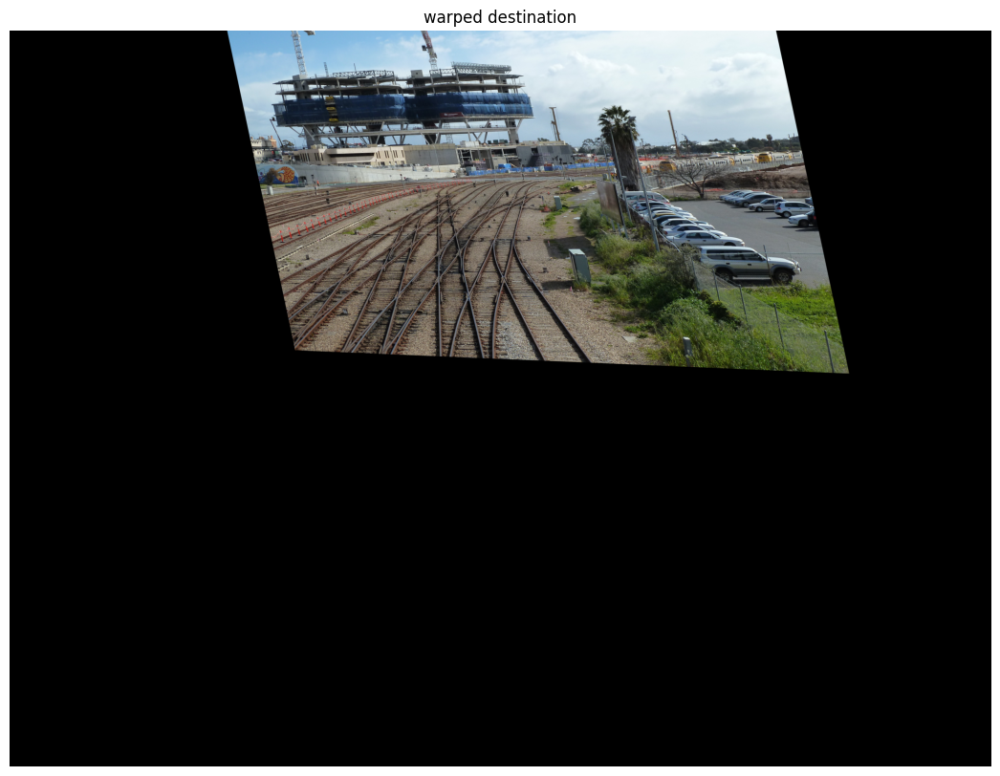

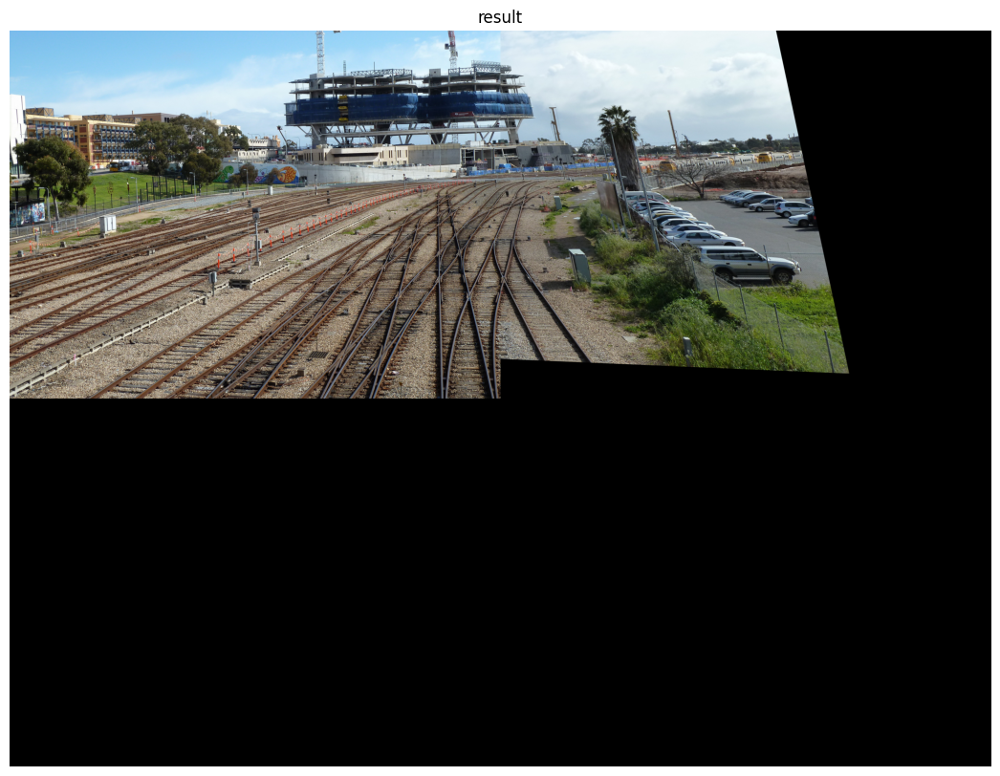

In [21]:
result = cv.warpPerspective(des_rgb, H, (src_rgb.shape[1] + des_rgb.shape[1], src_rgb.shape[0] + des_rgb.shape[0]))
plot(result, 'warped destination', figsize=(30, 10))
result[:src_rgb.shape[0], :src_rgb.shape[1]] = src_rgb
plot(result, 'result', figsize=(30, 10))

### Step five: removing empty spaces
To be cautious, the underlying canvas's width was set to be equal to `src.width + des.width`, and height as `src.height + width.height` as in the worst case, they would have little overlapping. Thus, it is required to remove the empty areas in general.

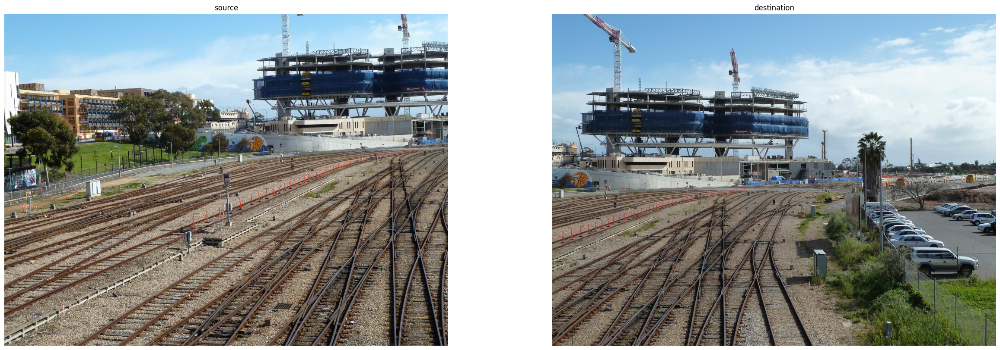

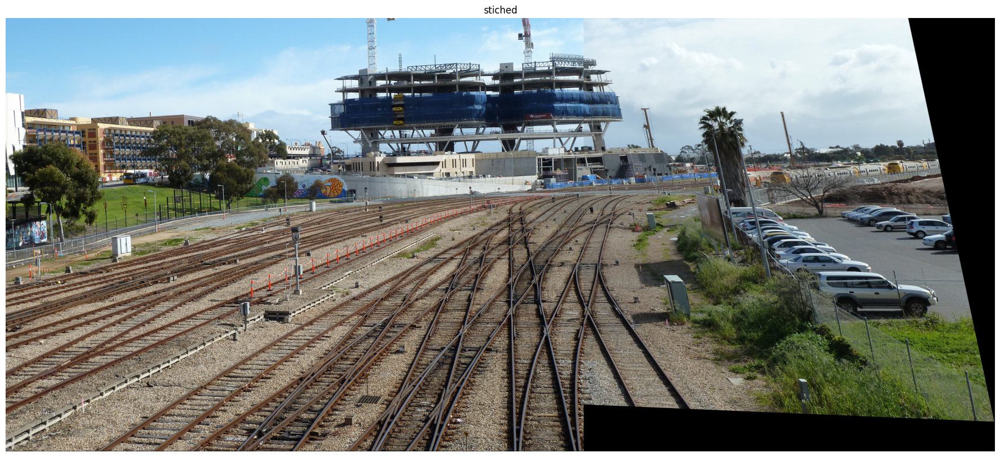

In [22]:
result = remove_empty_space(result)
biplot(src_rgb, des_rgb, 'source', 'destination', figsize=(30, 10))
plot(result, 'stiched', figsize=(30, 10))

### Multiple Stitching (i.e., panorama):
The procedure is the same as for two images, with a difference. First all the pair-wise homography matrices are calculated between input patches. Then, in consequent stitching, the warping applied to $patch_i$ is via $H$ = $H_i \times H_{i-1}$.

In [23]:
def get_homography(src_img, des_img, sift, bf):
    src_keypoints, src_sift = sift.detectAndCompute(src_img, None)
    des_keypoints, des_sift = sift.detectAndCompute(des_img, None)
    matches = bf.knnMatch(src_sift, des_sift, k=2)
    good = []
    for m in matches:
        if m[0].distance < 0.5 * m[1].distance:
            good.append(m)
    if len(good) < 4:
        raise AssertionError('not enough matching keypoints found')
    matches = np.asarray(good)
    src = np.float32(
        [src_keypoints[m.queryIdx].pt for m in matches[:, 0]]).reshape(-1, 1, 2)
    des = np.float32(
        [des_keypoints[m.trainIdx].pt for m in matches[:, 0]]).reshape(-1, 1, 2)
    H, _ = cv.findHomography(des, src, cv.RANSAC, 5.0)
    assert H is not None, 'Could not find homography'
    return H


In [24]:
def stitch(src, des, H):
    result = cv.warpPerspective(des, H, (src.shape[1] + des.shape[1], src.shape[0] + des.shape[0]))
    result[:src.shape[0], :src.shape[1], :] = src
    return remove_empty_space(result)

When stitching multiple images, we will face distortion if we start from left to right for the patches. Thus, first, the second half of the patches are stitched, and then the first half. Warping is applied to the image on the right in my implementation. Thus, after finishing with the right side (second half), I mirror the result and start with the left side (first half). The following functions do the mirroring.

In [27]:
def mirror_gray(img):
    return img[:, ::-1]

def mirror_rgb(img):
    return img[:, ::-1, :]

In [28]:
def panorama(rgbs):
    sift = cv.SIFT_create()
    matcher = cv.BFMatcher()
    grays = []
    for i in range(len(rgbs)):
        grays.append(convert_to_grayscale(rgbs[i]))
    middle_ix = len(rgbs) // 2
    result = rgbs[middle_ix]
    for i in range(middle_ix +1, len(grays)):
        H = get_homography(convert_to_grayscale(result), grays[i], sift, matcher)
        result = stitch(result, rgbs[i], H)
    result = mirror_rgb(result)
    for i in range(middle_ix - 1, -1, -1):
        H = get_homography(convert_to_grayscale(result), mirror_gray(grays[i]), sift, matcher)
        result = stitch(result, mirror_rgb(rgbs[i]), H)
    result = mirror_rgb(result)
    return result

#### Result for the APAP dataset - 1
Zaragoza et. al "As-Projective-As-Possible Image Stitching with Moving DLT," 2013

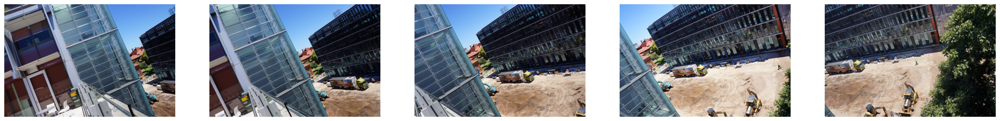

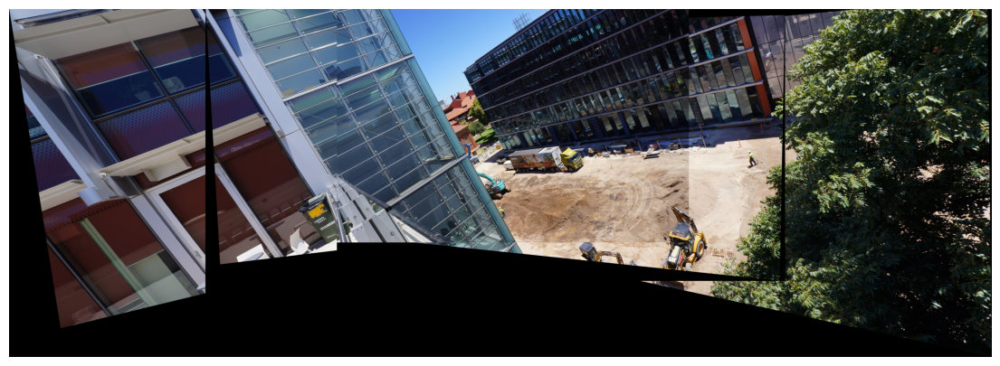

In [11]:
input_patches = read_rgb_images('input/pano/dataset_2')
plot_multiple(input_patches, figsize=(30, 5))
result = panorama(input_patches)
plot(result, figsize=(30, 5))


#### Result for the APAP dataset - 2
Zaragoza et. al "As-Projective-As-Possible Image Stitching with Moving DLT," 2013

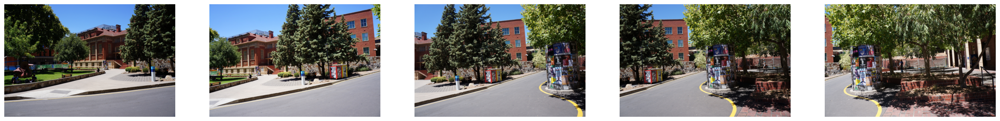

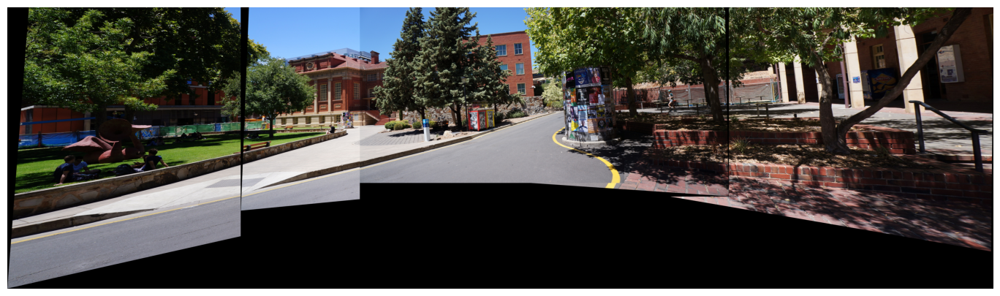

In [12]:
input_patches = read_rgb_images('input/pano/dataset_3')
plot_multiple(input_patches, figsize=(30, 5))
result = panorama(input_patches)
plot(result, figsize=(30, 5))


#### Results for my dataset

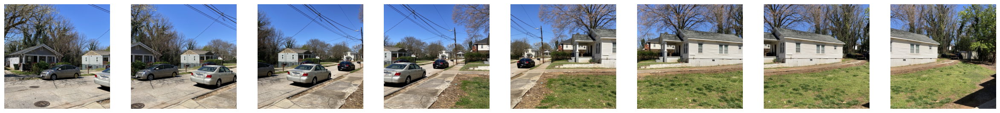

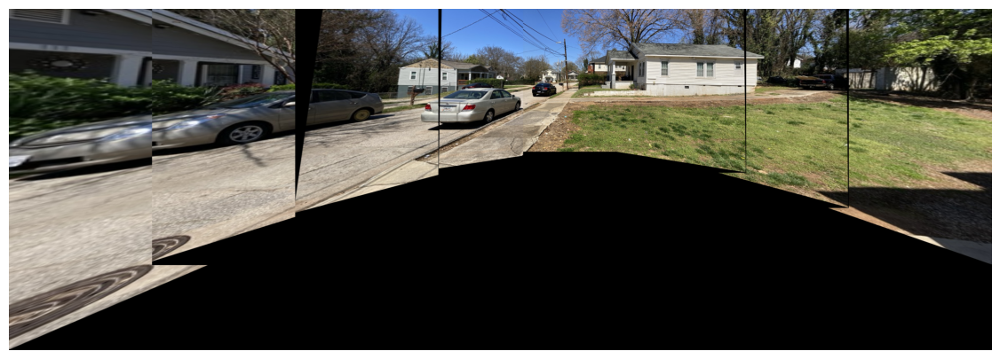

In [13]:
input_patches = read_rgb_images('input/pano/dataset_4')
plot_multiple(input_patches, figsize=(30, 5))
result = panorama(input_patches)
plot(result, figsize=(30, 5))


<hr>

## Question 6
<h4>
Integrate the applications developed for problems 4 and 5 with the web application developed in Assignment 1 problem 4
</h4>

Please find the screen recordings in the attachments.

Accessible through <a href="https://rezmansouri.github.io/csc8830">https://rezmansouri.github.io/csc8830</a>.